In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import numpy as np
import os
import io
from typing import List
from PIL import Image, ImageDraw, ImageFont
import math

# Visualise buildings

In [7]:
EMBEDDINGS_NPY_ARRAY_PATH = "data/landmarks_satellite_max_urban/embeddings.npy"
EMBEDDINGS_METADATA_CSV_PATH = "data/landmarks_satellite_max_urban/info.csv"
IMAGES_ROOT_FOLDER_PATH = "data/vpair/reference_views"

# Drone config (UPDATED PATHS)
DRONE_EMBEDDINGS_NPY_ARRAY_PATH = "data/landmarks_drone_max_urban/embeddings.npy"
DRONE_EMBEDDINGS_METADATA_CSV_PATH = "data/landmarks_drone_max_urban/info.csv"
DRONE_IMAGES_ROOT_FOLDER_PATH = "data/vpair/queries"

RESULTS_FOLDER = "data/landmarks_ui_results"
EMBEDDING_COORDS_ROOT = "data/embedding_coords_cache"

LAYER_TO_DIM = {
    0: 16,
    1: 32,
    2: 64,
    3: 64,
    4: 128,
    5: 128,
    6: 128,
    7: 256,
    8: 256,
    9: 256,
    10: 256
}


def get_all_satellite_embeddings(conf_threshold, used_layers):
    """
    Returns (df_meta_filtered, sat_emb_filtered).
    """
    df_all = pd.read_csv(EMBEDDINGS_METADATA_CSV_PATH)
    emb_all = np.load(EMBEDDINGS_NPY_ARRAY_PATH)
    mask = df_all["conf"] >= conf_threshold
    df_filtered = df_all[mask].copy().reset_index(drop=True)
    emb_filtered = emb_all[mask.values]
    if used_layers:
        emb_filtered = get_embeddings_for_layers(emb_filtered, used_layers)
    return df_filtered, emb_filtered


def get_all_drone_embeddings(conf_threshold, used_layers):
    """
    Returns (df_drone_filtered, drone_emb_filtered).
    """
    df_all = pd.read_csv(DRONE_EMBEDDINGS_METADATA_CSV_PATH)
    emb_all = np.load(DRONE_EMBEDDINGS_NPY_ARRAY_PATH)
    mask = df_all["conf"] >= conf_threshold
    df_filtered = df_all[mask].copy().reset_index(drop=True)
    emb_filtered = emb_all[mask.values]
    if used_layers:
        emb_filtered = get_embeddings_for_layers(emb_filtered, used_layers)
    return df_filtered, emb_filtered


def get_embeddings_for_layers(embeddings: np.ndarray, layers: list, layer_to_dim: dict = LAYER_TO_DIM) -> np.ndarray:
    invalid_layers = [layer for layer in layers if layer not in layer_to_dim]
    if invalid_layers:
        raise ValueError(f"Layers {invalid_layers} are not present in layer_to_dim mapping.")

    layer_start_indices = {}
    current_index = 0
    for layer in sorted(layer_to_dim.keys()):
        layer_start_indices[layer] = current_index
        current_index += layer_to_dim[layer]

    selected_columns = []
    for layer in layers:
        start = layer_start_indices[layer]
        dim = layer_to_dim[layer]
        selected_columns.extend(range(start, start + dim))
    return embeddings[:, selected_columns]


def draw_boxes_on_image(image_path, instances_info, color: str = None):
    """
    Draw bounding boxes for one or more instances on a single image.
    If label_val == -1 => red bounding box, else blue bounding box.
    The font size is set to 30 for clearer labeling.
    """
    im = Image.open(image_path).convert("RGB")
    draw = ImageDraw.Draw(im)
    # Use a bigger default font
    font = ImageFont.load_default(size=30)
    try:
        # Pillow doesn't actually implement load_default(size=30) in many versions,
        # so you can either attempt it or fallback. We'll attempt.
        font.size = 30
    except Exception as e:
        pass

    for info in instances_info:
        x0, y0, x1, y1 = info["box"]
        instance_id = info["instance_id"]
        label_val = info.get("label_val", 0)
        if color is None:
            color = "#fc0303" if label_val == -1 else "blue"

        draw.rectangle([(x0, y0), (x1, y1)], outline=color, width=12)
        # label_txt = f"ID:{instance_id}"
        # draw.text((x0, y0), label_txt, fill=color, font=font)
    return im



In [8]:
def visualise_retrieved_buildings(
    image_filename: str,
    drone_building_id: int,
    satellite_building_id: int,
    orientation: str = "horizontal",
    df_drone_full=None,
    dr_emb_full=None,
    df_sat_full=None,
    sat_emb_full=None,
    save_pdf: bool = True,
    pdf_name: str = None
):
    """
    Visualise the drone building, the corresponding 'true' satellite building,
    plus the top-5 most similar satellite buildings.

    Parameters:
    -----------
    image_filename : str
        The filename (e.g., "00001.png") shared by the drone and satellite images.
    drone_building_id : int
        The local index into df_drone_full for the building-of-interest on the drone image.
    satellite_building_id : int
        The local index into df_sat_full for the building-of-interest on the satellite image.
    orientation : str, optional
        "horizontal" or "vertical". Determines whether the 7 images are shown
        side-by-side or stacked top-to-bottom.
    df_drone_full : pd.DataFrame
        A DataFrame of all drone buildings, loaded from DRONE_EMBEDDINGS_METADATA_CSV_PATH,
        filtered by confidence threshold, with global or local IDs, bounding boxes, etc.
    dr_emb_full : np.ndarray
        A 2D array of shape (N, embedding_dim) for the drone buildings in df_drone_full.
    df_sat_full : pd.DataFrame
        A DataFrame of all satellite buildings, loaded from EMBEDDINGS_METADATA_CSV_PATH,
        filtered by confidence threshold, with bounding boxes, etc.
    sat_emb_full : np.ndarray
        A 2D array of shape (M, embedding_dim) for the satellite buildings in df_sat_full.

    Returns:
    --------
    fig : matplotlib.figure.Figure
        A matplotlib Figure object containing the 7 subplots (drone, true sat, top-5).
    """

    plt.style.use('ggplot')
    
    # ----------------------------------------------------------------
    # 0) Some checks:
    # ----------------------------------------------------------------
    if df_drone_full is None or dr_emb_full is None or df_sat_full is None or sat_emb_full is None:
        raise ValueError("df_drone_full, dr_emb_full, df_sat_full, sat_emb_full must be provided.")

    if not (0 <= drone_building_id < len(df_drone_full)):
        raise IndexError(f"drone_building_id {drone_building_id} out of range for df_drone_full.")
    if not (0 <= satellite_building_id < len(df_sat_full)):
        raise IndexError(f"satellite_building_id {satellite_building_id} out of range for df_sat_full.")

    # ----------------------------------------------------------------
    # 1) Drone building bounding box (the "reference" building)
    # ----------------------------------------------------------------
    row_drone = df_drone_full.iloc[drone_building_id]
    # The bounding box
    dr_box = (row_drone["box_0"], row_drone["box_1"], row_drone["box_2"], row_drone["box_3"])
    # Prepare annotation info
    drone_info = [{
        "box": dr_box,
        "instance_id": drone_building_id,
        "label_val": 0  # or check if you store outlier labels for drone
    }]

    # We'll assume you have a helper function 'draw_boxes_on_image(path, instances_info)' 
    # that returns a PIL Image with bounding boxes drawn in. 
    # If the drone image is at DRONE_IMAGES_ROOT_FOLDER_PATH:
    drone_img_path = os.path.join(DRONE_IMAGES_ROOT_FOLDER_PATH, image_filename)
    annotated_drone_pil = draw_boxes_on_image(drone_img_path, drone_info, color='red')

    # ----------------------------------------------------------------
    # 2) The "true" satellite bounding box (the "paired" building)
    # ----------------------------------------------------------------
    row_sat_true = df_sat_full.iloc[satellite_building_id]
    sat_box_true = (row_sat_true["box_0"], row_sat_true["box_1"], row_sat_true["box_2"], row_sat_true["box_3"])
    sat_true_info = [{
        "box": sat_box_true,
        "instance_id": satellite_building_id,
        "label_val": row_sat_true.get("label", 0)  # if you store outlier label
    }]
    sat_img_path_true = os.path.join(IMAGES_ROOT_FOLDER_PATH, image_filename)
    annotated_sat_true_pil = draw_boxes_on_image(sat_img_path_true, sat_true_info, color='red')

    # ----------------------------------------------------------------
    # 3) Retrieve top-5 from ALL satellite embeddings for the given drone building
    # ----------------------------------------------------------------
    # We'll do the same approach:
    def l2_dist(a, b):
        return np.sqrt(np.sum((a - b) ** 2))

    query_vec = dr_emb_full[drone_building_id]
    dist_list = []
    for i in range(len(sat_emb_full)):
        dist_val = l2_dist(query_vec, sat_emb_full[i])
        dist_list.append((dist_val, i))
    dist_list.sort(key=lambda x: x[0])
    top5 = dist_list[:5]

    # We'll store each top-k building as a PIL image with bounding box
    top5_images = []
    for rank_idx, (dist_val, sat_idx) in enumerate(top5):
        row_sat = df_sat_full.iloc[sat_idx]
        box_ = (row_sat["box_0"], row_sat["box_1"], row_sat["box_2"], row_sat["box_3"])
        sat_info_k = [{
            "box": box_,
            "instance_id": sat_idx,
            "label_val": row_sat.get("label", 0)
        }]
        sat_img_path_k = os.path.join(IMAGES_ROOT_FOLDER_PATH, row_sat["image"])
        annotated_pil_k = draw_boxes_on_image(sat_img_path_k, sat_info_k, color='red')
        top5_images.append({
            "rank": rank_idx+1,
            "pil_img": annotated_pil_k,
            "dist": dist_val,
            "image_file": row_sat["image"]
        })

    # ----------------------------------------------------------------
    # 4) Build a matplotlib figure with 7 subplots: 
    #    drone => sat(true) => top1 => top2 => top3 => top4 => top5
    # ----------------------------------------------------------------

    # Decide layout
    if orientation == "vertical":
        fig, axes = plt.subplots(nrows=7, ncols=1, figsize=(6, 30))
        axes = axes.flatten()
    else:
        # default "horizontal"
        fig, axes = plt.subplots(nrows=1, ncols=7, figsize=(35, 5))
        axes = axes.flatten()

    # Helper to show a PIL image on an axis
    def show_pil_on_axis(pil_img, ax, title: str = "", caption: str = ""):
        """
        Helper to show a PIL image on a Matplotlib axis with bold, large text.

        Parameters
        ----------
        pil_img : PIL.Image
            The image to display.
        ax : matplotlib.axes.Axes
            The axis to display the image on.
        title : str
            The title for the subplot.
        caption : str
            The caption (used as xlabel).
        """
        ax.imshow(pil_img)
        ax.set_title(title, fontsize=16, fontweight='bold')
        ax.set_xlabel(caption, fontsize=14, fontweight='bold')
        ax.set_xticks([])
        ax.set_yticks([])

    # Subplot 0 => drone
    show_pil_on_axis(
        annotated_drone_pil,
        axes[0],
        title="Building from UAV image",
        caption=image_filename
    )

    # Subplot 1 => satellite true
    show_pil_on_axis(
        annotated_sat_true_pil,
        axes[1],
        title="Building from satellite image",
        caption=image_filename
    )

    # Next 5 => top-k satellite
    for k in range(5):
        rank = k + 1
        topk_img_dict = top5_images[k]
        show_pil_on_axis(
            topk_img_dict["pil_img"],
            axes[k+2],
            title=f"Top-{rank} similar building from satellite",
            caption=topk_img_dict["image_file"]
        )

    plt.tight_layout()
    
    for ax in axes.flatten():
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_xlabel(ax.get_xlabel(), fontsize=14, fontweight='bold')
        ax.set_ylabel(ax.get_ylabel(), fontsize=14, fontweight='bold')
        ax.set_title(ax.get_title(), fontsize=16, fontweight='bold')
    fig.suptitle('Retrieved Buildings', fontsize=18, fontweight='bold')

    if save_pdf:
        out_dir = os.path.join('data', 'visualizations', 'visualise_retrieved_buildings')
        os.makedirs(out_dir, exist_ok=True)
        if pdf_name is None:
            pdf_name = 'retrieved_buildings.pdf'
        fig.savefig(os.path.join(out_dir, pdf_name), bbox_inches='tight')
    
    return fig


def visualise_buildings_by_building_ids(
    building_ids: List[int],
    source: str,
    orientation: str,
    new_line_after_n_img: int,
    df_drone_full,
    df_sat_full,
    drone_images_root: str,
    satellite_images_root: str,
    draw_boxes_on_image_func,
    save_pdf: bool = True,
    pdf_name: str = None
):
    """
    Visualise a list of building IDs from either the "drone" or "satellite" dataset,
    drawing bounding boxes on each building's image. The images are arranged in a grid,
    either horizontally or vertically, with a user-specified 'wrap' after
    'new_line_after_n_img'.

    Parameters
    ----------
    building_ids : List[int]
        A list of building IDs (row indices in the chosen source DataFrame).
    source : str
        Either "drone" or "satellite", indicating which dataset to pull from.
    orientation : str
        Either "horizontal" or "vertical", controlling the main layout direction.
        - "horizontal": images flow left-to-right, then wrap to a new row.
        - "vertical": images flow top-to-bottom, then wrap to a new column.
    new_line_after_n_img : int
        How many images to place in a row (if orientation="horizontal") or column
        (if orientation="vertical") before continuing on a new line or new column.
    df_drone_full : pd.DataFrame
        A DataFrame of drone-building metadata, containing columns:
          ["image", "box_0", "box_1", "box_2", "box_3", ...]
    df_sat_full : pd.DataFrame
        A DataFrame of satellite-building metadata, containing the same columns.
    dr_images_root : str
        Filesystem path to the folder containing drone images.
    sat_images_root : str
        Filesystem path to the folder containing satellite images.
    draw_boxes_on_image_func : callable
        A function `fn(image_path, instances_info) -> PIL.Image` that draws bounding
        boxes on the image. Each item in `instances_info` is a dict:
          {
            "box": (x0, y0, x1, y1),
            "instance_id": int,
            "label_val": int/float
          }

    Returns
    -------
    fig : matplotlib.figure.Figure
        The resulting matplotlib Figure with subplots of bounding‐box images.
    """

    plt.style.use('ggplot')
    
    # Pick the correct DataFrame & images root
    if source not in ("drone", "satellite"):
        raise ValueError("source must be 'drone' or 'satellite'")

    if source == "drone":
        df_source = df_drone_full
        images_root = drone_images_root
    else:
        df_source = df_sat_full
        images_root = satellite_images_root

    # Validate building_ids
    for b_id in building_ids:
        if b_id < 0 or b_id >= len(df_source):
            raise IndexError(f"Building id {b_id} is out of range for {source} DataFrame.")

    # Decide the total number of images
    N = len(building_ids)

    # Decide how to break them into a grid
    if orientation == "horizontal":
        # We'll have rows = ceil(N / new_line_after_n_img)
        # and columns = min(new_line_after_n_img, N) for the last row if partial
        n_rows = math.ceil(N / new_line_after_n_img)
        n_cols = min(new_line_after_n_img, N)
    elif orientation == "vertical":
        # We'll have columns = ceil(N / new_line_after_n_img)
        # and rows = min(new_line_after_n_img, N)
        n_cols = math.ceil(N / new_line_after_n_img)
        n_rows = min(new_line_after_n_img, N)
    else:
        raise ValueError("orientation must be 'horizontal' or 'vertical'")

    # Create the figure
    # We'll pick a size that scales with number of images
    fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(5 * n_cols, 5 * n_rows))
    # If there's only one row or one column, `axes` may not be a 2D array
    if n_rows == 1 and n_cols == 1:
        axes = np.array([[axes]])
    elif n_rows == 1:
        axes = np.array([axes])  # shape => (1, n_cols)
    elif n_cols == 1:
        axes = np.array([[ax] for ax in axes])  # shape => (n_rows, 1)
    else:
        # axes is already shape (n_rows, n_cols)
        pass

    # Flatten the (n_rows, n_cols) for easy iteration
    axes_flat = axes.flatten()

    for i, b_id in enumerate(building_ids):
        # We'll retrieve the row => bounding box => image
        row = df_source.iloc[b_id]
        image_file = row["image"]
        box = (row["box_0"], row["box_1"], row["box_2"], row["box_3"])
        instance_info = [{
            "box": box,
            "instance_id": b_id,
            "label_val": 0  # or row.get("label", 0) if there's a label
        }]

        full_img_path = os.path.join(images_root, image_file)
        pil_annotated = draw_boxes_on_image_func(full_img_path, instance_info, color='red')

        ax = axes_flat[i]
        ax.imshow(pil_annotated)
        # ax.set_title(f"Building ID: {b_id}", fontsize=12)
        # The "caption" => put in the X-label so it's displayed below the image:
        ax.set_xlabel(image_file, fontsize=18)

        ax.set_xticks([])
        ax.set_yticks([])

    # Hide remaining axes if there are empty ones
    for j in range(i + 1, len(axes_flat)):
        axes_flat[j].axis("off")

    plt.tight_layout()
    
    for ax in axes.flatten():
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_xlabel(ax.get_xlabel(), fontsize=14, fontweight='bold')
        ax.set_ylabel(ax.get_ylabel(), fontsize=14, fontweight='bold')
        ax.set_title(ax.get_title(), fontsize=16, fontweight='bold')
    fig.suptitle('Buildings by ID', fontsize=18, fontweight='bold')

    if save_pdf:
        out_dir = os.path.join('data', 'visualizations', 'visualise_buildings_by_building_ids')
        os.makedirs(out_dir, exist_ok=True)
        if pdf_name is None:
            pdf_name = 'buildings_by_id.pdf'
        fig.savefig(os.path.join(out_dir, pdf_name), bbox_inches='tight')
    
    return fig

In [9]:
df_drone_full, dr_emb_full = get_all_drone_embeddings(conf_threshold=0.5, used_layers=[4,6,8,10])
df_sat_full, sat_emb_full   = get_all_satellite_embeddings(conf_threshold=0.5, used_layers=[4,6,8,10])

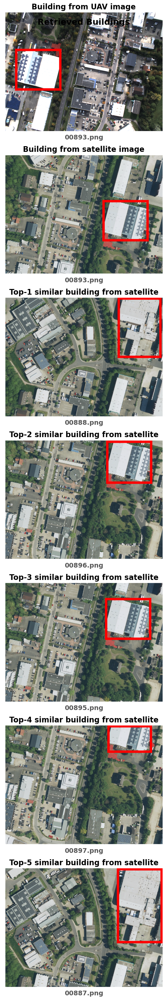

In [10]:
fig = visualise_retrieved_buildings(
    image_filename="00893.png",
    drone_building_id=11235,
    satellite_building_id=11479,
    orientation="vertical",
    # orientation="horizontal",
    df_drone_full=df_drone_full,
    dr_emb_full=dr_emb_full,
    df_sat_full=df_sat_full,
    sat_emb_full=sat_emb_full
)
plt.show()

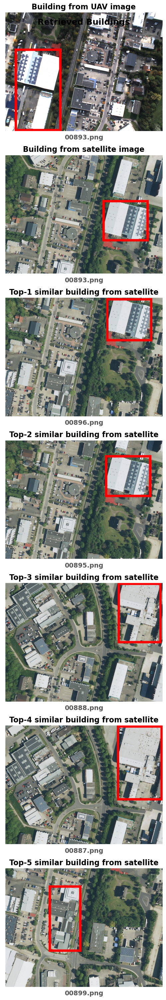

In [11]:
fig = visualise_retrieved_buildings(
    image_filename="00893.png",
    drone_building_id=11237,
    satellite_building_id=11479,
    orientation="vertical",
    # orientation="horizontal",
    df_drone_full=df_drone_full,
    dr_emb_full=dr_emb_full,
    df_sat_full=df_sat_full,
    sat_emb_full=sat_emb_full
)
plt.show()

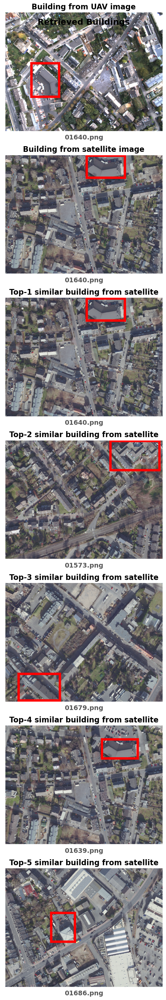

In [12]:
fig = visualise_retrieved_buildings(
    image_filename="01640.png",
    drone_building_id=14812,
    satellite_building_id=15759,
    orientation="vertical",
    # orientation="horizontal",
    df_drone_full=df_drone_full,
    dr_emb_full=dr_emb_full,
    df_sat_full=df_sat_full,
    sat_emb_full=sat_emb_full
)
plt.show()

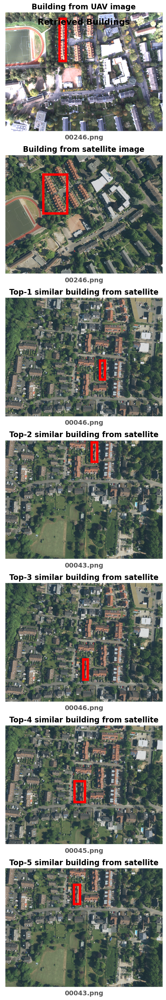

In [13]:
fig = visualise_retrieved_buildings(
    image_filename="00246.png",
    drone_building_id=5257,
    satellite_building_id=4608,
    orientation="vertical",
    # orientation="horizontal",
    df_drone_full=df_drone_full,
    dr_emb_full=dr_emb_full,
    df_sat_full=df_sat_full,
    sat_emb_full=sat_emb_full
)
plt.show()

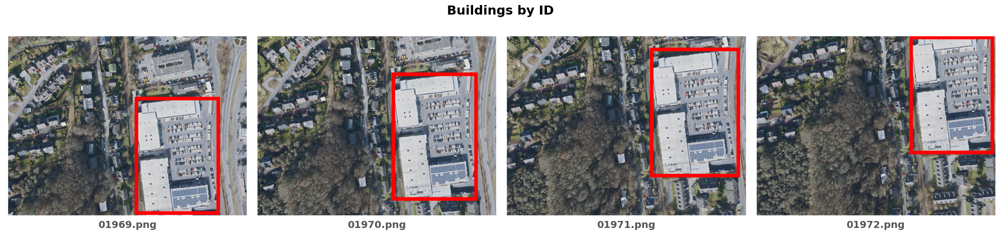

In [14]:
fig = visualise_buildings_by_building_ids(
    building_ids=[18577, 18611, 18613, 18627],
    source="satellite",
    orientation="horizontal",
    new_line_after_n_img=4,
    df_sat_full=df_sat_full,
    df_drone_full=df_drone_full,
    satellite_images_root=IMAGES_ROOT_FOLDER_PATH,
    drone_images_root=DRONE_IMAGES_ROOT_FOLDER_PATH,
    draw_boxes_on_image_func=draw_boxes_on_image
)
plt.show()

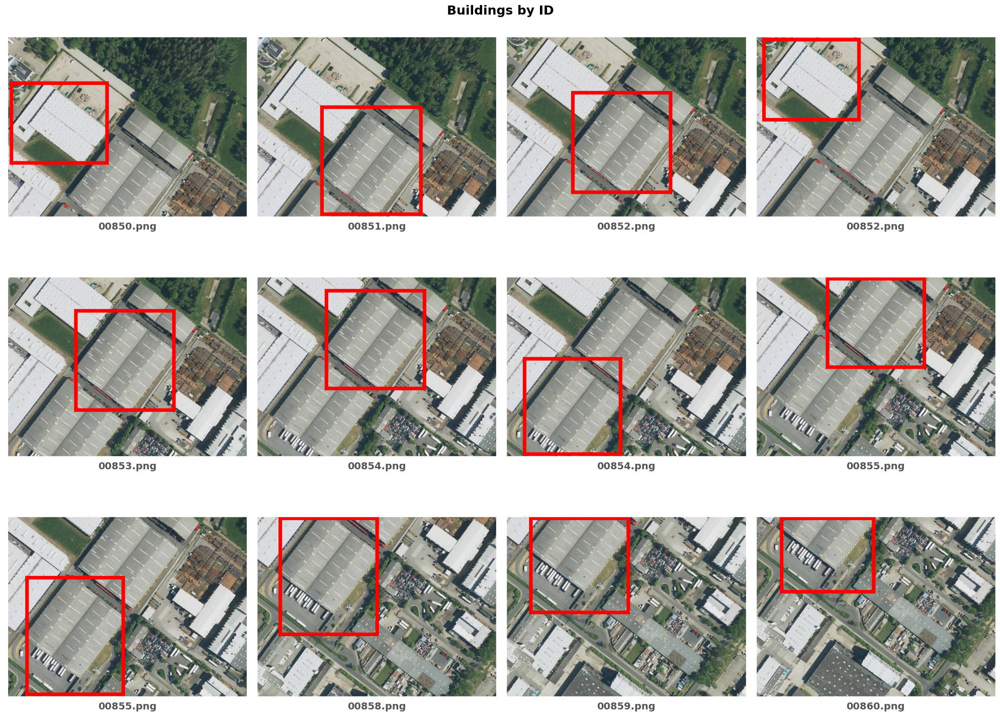

In [15]:
fig = visualise_buildings_by_building_ids(
    building_ids=[10926, 10932, 10937, 10936, 10951, 10954, 10952, 10962, 10963, 10996, 11005, 11017],
    source="satellite",
    orientation="horizontal",
            new_line_after_n_img=4,
    df_sat_full=df_sat_full,
    df_drone_full=df_drone_full,
    satellite_images_root=IMAGES_ROOT_FOLDER_PATH,
    drone_images_root=DRONE_IMAGES_ROOT_FOLDER_PATH,
    draw_boxes_on_image_func=draw_boxes_on_image
)
plt.show()

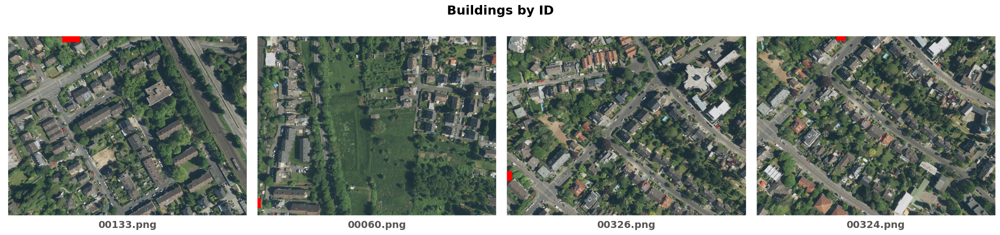

In [16]:
fig = visualise_buildings_by_building_ids(
    building_ids=[1699, 960, 5657, 5563],
    source="satellite",
    orientation="horizontal",
    new_line_after_n_img=4,
    df_sat_full=df_sat_full,
    df_drone_full=df_drone_full,
    satellite_images_root=IMAGES_ROOT_FOLDER_PATH,
    drone_images_root=DRONE_IMAGES_ROOT_FOLDER_PATH,
    draw_boxes_on_image_func=draw_boxes_on_image
)
plt.show()

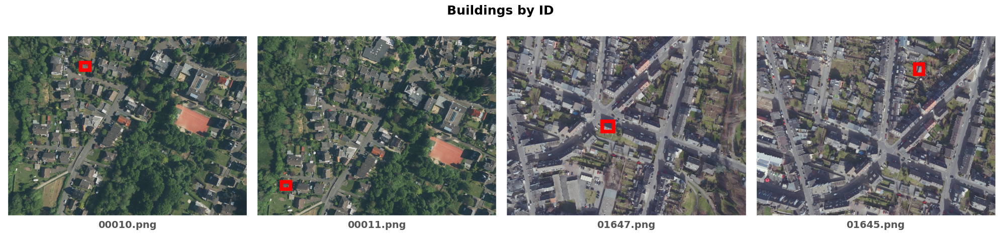

In [17]:
fig = visualise_buildings_by_building_ids(
    building_ids=[72, 115, 15908, 15858],
    source="satellite",
    orientation="horizontal",
    new_line_after_n_img=4,
    df_sat_full=df_sat_full,
    df_drone_full=df_drone_full,
    satellite_images_root=IMAGES_ROOT_FOLDER_PATH,
    drone_images_root=DRONE_IMAGES_ROOT_FOLDER_PATH,
    draw_boxes_on_image_func=draw_boxes_on_image
)
plt.show()